Cartwheels  Copyright (C) 2024  Alwyn Aswin

# Chart my wheels
## A notebook to analyze package dependencies

### Motivations

1. We want to understand our package dependencies
2. We want to know which packages are connected to each other
3. Get an idea what different package combination is possible
4. Figure out which packages are transitive and which ones must be declared in `setup.py` or `requirements.txt`

### Challenges

To limit the problem space, we limit the search to the trailing `n`-packages. However, within this constraint the packages themselves are free to move and re-combine. Nevertheless this is still an `n^m` search space. Where `m` is the number of dependencies referenced.  


### Install packages

Check to make sure you opened the notebook in a virtual environment (Or Conda), or this could pollute your default python installation.

In [1]:
from cartwheels.chart_pkgs import ChartPackages
from cartwheels.pkg_graph import PkgGraph
import aiohttp

### List of packages to inspect
Edit the list below to Analyze different set of packages. But let's take a look at the "common" packages in analytics space

NOTE: You can edit the `resolve` call from `resolve(False)` to `resolve(True)` depending on whether the cache is to be used or marked dirty.

In [2]:
dependencies = ["aiofiles", "aiohttp", "django", "mlflow", "scipy", "pytorch", "mlflow", "scipy", "sklearn",
                "tensorflow", "pyspark", "pandas", "numpy", "sqlalchemy"]

In [3]:
trailing = 5


async def get_deps():
    async with aiohttp.ClientSession() as session:
        return await PkgGraph(
            dependencies, session, trailing).resolve()

### Get meta information about your dependencies

Reach out to pypi and look at ALL versions of a given package.

Traverse and convert the packages into `PkgNfo` and store them as data objects.

Grab a popcorn this will take a while. When done, `PkgGraph` will create a `.pkl` file to cache the meta information. This cache is valid for up to a month, so we won't have to grow through this anytime soon.



In [4]:
pkg_graph = await get_deps()

### Chart Packages

Extract the relationships between package versions into:

1. Vertices
2. Edges
3. Adjacency Matrix
4. Provide index lookups

In [5]:
chart = ChartPackages(pkg_graph.pkgs)

### Calculate the laplacian of the matrix
```
L = D - A
```
L is the Laplacian matrix
D is the Degree (Incident) Matrix, calculated by tallying up the adjacency column
A is the adjacency matrix 

The Laplacian is interesting as it has several properties to help make segmenting easier.

In [6]:
from cartwheels.pkg_matrix import PkgMatrix
import numpy as np

pkm = PkgMatrix(chart)

In [7]:
A = pkm.A

In [8]:
D = pkm.D

In [9]:
[(chart.vertices[i], chart.vertices[j]) for i, j in np.argwhere(A > 0)]

[('Flask::2.3.3', 'Jinja2::3.1.0'),
 ('Flask::2.3.3', 'Jinja2::3.1.1'),
 ('Flask::2.3.3', 'Jinja2::3.1.2'),
 ('Flask::2.3.3', 'Jinja2::3.1.3'),
 ('Flask::2.3.3', 'Jinja2::3.1.4'),
 ('Flask::2.3.3', 'click::8.1.3'),
 ('Flask::2.3.3', 'click::8.1.4'),
 ('Flask::2.3.3', 'click::8.1.5'),
 ('Flask::2.3.3', 'click::8.1.6'),
 ('Flask::2.3.3', 'click::8.1.7'),
 ('Flask::2.3.3', 'itsdangerous::2.0.1'),
 ('Flask::2.3.3', 'itsdangerous::2.1.0'),
 ('Flask::2.3.3', 'itsdangerous::2.1.1'),
 ('Flask::2.3.3', 'itsdangerous::2.1.2'),
 ('Flask::2.3.3', 'itsdangerous::2.2.0'),
 ('Flask::3.0.0', 'Jinja2::3.1.0'),
 ('Flask::3.0.0', 'Jinja2::3.1.1'),
 ('Flask::3.0.0', 'Jinja2::3.1.2'),
 ('Flask::3.0.0', 'Jinja2::3.1.3'),
 ('Flask::3.0.0', 'Jinja2::3.1.4'),
 ('Flask::3.0.0', 'Werkzeug::2.3.8'),
 ('Flask::3.0.0', 'Werkzeug::3.0.0'),
 ('Flask::3.0.0', 'Werkzeug::3.0.1'),
 ('Flask::3.0.0', 'Werkzeug::3.0.2'),
 ('Flask::3.0.0', 'Werkzeug::3.0.3'),
 ('Flask::3.0.0', 'click::8.1.3'),
 ('Flask::3.0.0', 'click::8.1.

In [10]:
L = pkm.L

### Get the eigen values

The eigen values of the Laplacian carry several significance:

* The first non-zero eigen value spectral gap, and it gives a notion on how dense the graph is.
    If only one then everything is connected.
* The second non-zero eigen value is the Fieldler value, which tells us how many cuts are needed to separate the graph into 2. You can use the corresponding vector to seperate the graph into 2, eg. based on whether the vector component value is positive or negative.

In [11]:
eigen_values, eigen_vectors, order = pkm.Es

In [12]:
print(eigen_values.shape)
print(eigen_vectors.shape)
print(order.shape)

(1885,)
(1885, 1885)
(1885,)


In [13]:
import matplotlib.pyplot as plt

[ 0.  0.  0. ... 30. 30. 30.]


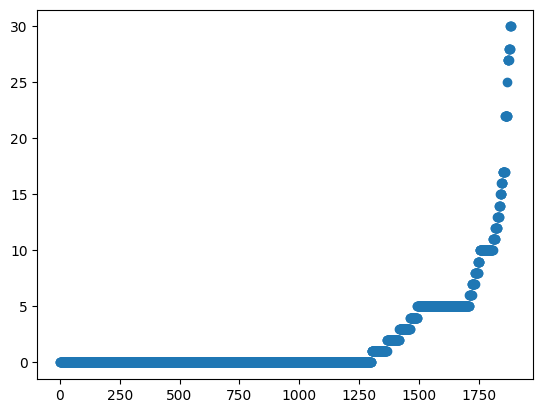

In [14]:
print(eigen_values)
# start = np.argwhere(eigen_values[np.argsort(eigen_values)]>0)[0][0]
# plt.scatter([i for i in  range(100)], eigen_values[np.argsort(eigen_values)][start:start+100])
plt.scatter([i for i in range(len(eigen_values))], eigen_values)

**If you see, that there are a lot of leading zeroes in the graph above, the package connectivity is very "sparse"**

Before you try and find compatibility sets you want to remove the independent packages, as they will cause the number of compatibility sets to explode. If not filtered out, the pkg compatibility sets solver will *never* finish.

In [15]:
from scipy import stats

number_of_parts = stats.mode(eigen_values[eigen_values > 0])
from IPython.display import Markdown as md

md(f'### Observing the chart\nThe saddle point (from the mode) for the eigenvalues is {number_of_parts.mode}, this is a good indicator that there are **{number_of_parts.mode}** distinct connected groups at play')

### Observing the chart
The saddle point (from the mode) for the eigenvalues is 5.0, this is a good indicator that there are **5.0** distinct connected groups at play

### Using Graph theory to drop off independent packages

Independent packages are not constrained, hence they cause an explosion of possible solution. 

They are also irrelevant, as you simply pick the latest, you do not have to worry about compatibility sets, as they are by definition independent.

In the following steps we want to:

1. Use graph theory to weed out the independent packages
2. Find solutions (aka. compatibility sets) of the remaining package that is connected by one or more edge. These may be multiple independent graphs, but they are at least "interesting" to look at.

Future work - we can group these connected packages into independent graphs, and solve them separately.

In [16]:
pkm.shrink_A(dependencies)

In [17]:
pkm.A.shape

(626, 626)

In [18]:
*_, last = pkm.Cs

In [19]:
no_connections = np.argwhere(np.sum(last, 0) == 0)
print(no_connections)
md(f'Even though we "traversed" when we pulled these packages, we traversed them based on package reference and picked `{trailing}` recent versions. As such some of the versions we pulled may not fit the version specific dependencies. To optimize we want to cull `{len(no_connections)}` versions that are not compatible with any package')

[[  5]
 [  6]
 [  7]
 [  8]
 [  9]
 [ 10]
 [ 11]
 [ 12]
 [ 13]
 [ 14]
 [ 15]
 [ 16]
 [ 17]
 [ 18]
 [ 19]
 [ 25]
 [ 26]
 [ 27]
 [ 28]
 [ 29]
 [ 30]
 [ 31]
 [ 32]
 [ 33]
 [ 34]
 [ 35]
 [ 36]
 [ 37]
 [ 38]
 [ 39]
 [ 40]
 [ 41]
 [ 42]
 [ 43]
 [ 44]
 [ 45]
 [ 46]
 [ 47]
 [ 48]
 [ 49]
 [ 55]
 [ 56]
 [ 57]
 [ 58]
 [ 59]
 [ 60]
 [ 61]
 [ 62]
 [ 63]
 [ 64]
 [ 65]
 [ 66]
 [ 67]
 [ 68]
 [ 69]
 [ 80]
 [ 81]
 [ 82]
 [ 83]
 [ 84]
 [ 90]
 [ 91]
 [ 92]
 [ 93]
 [ 94]
 [ 95]
 [ 96]
 [ 97]
 [ 98]
 [ 99]
 [100]
 [101]
 [102]
 [103]
 [104]
 [105]
 [106]
 [107]
 [108]
 [109]
 [110]
 [111]
 [112]
 [113]
 [114]
 [115]
 [116]
 [117]
 [118]
 [119]
 [120]
 [121]
 [122]
 [123]
 [124]
 [133]
 [134]
 [135]
 [136]
 [137]
 [143]
 [144]
 [145]
 [146]
 [147]
 [148]
 [149]
 [150]
 [151]
 [152]
 [153]
 [154]
 [155]
 [156]
 [157]
 [163]
 [164]
 [165]
 [166]
 [167]
 [168]
 [169]
 [170]
 [171]
 [172]
 [178]
 [179]
 [180]
 [181]
 [182]
 [183]
 [184]
 [185]
 [186]
 [187]
 [188]
 [189]
 [190]
 [191]
 [192]
 [193]
 [194]
 [195]

Even though we "traversed" when we pulled these packages, we traversed them based on package reference and picked `5` recent versions. As such some of the versions we pulled may not fit the version specific dependencies. To optimize we want to cull `476` versions that are not compatible with any package

In [20]:
import random

independents = [chart.vertices[i] for i in np.argwhere(np.sum(last, 0) == 0).ravel().tolist()]
print(len(independents))
print([v for k, v in pkg_graph.pkgs.items() if k in independents], random.sample(dependencies, 10))

IOPub data rate exceeded.
The Jupyter server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--ServerApp.iopub_data_rate_limit`.

Current values:
ServerApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
ServerApp.rate_limit_window=3.0 (secs)



In [21]:
[v for k, v in pkg_graph.pkgs.items() if k not in independents]

[PkgNfo(name='metadata', version='0.1', dependencies=()),
 PkgNfo(name='metadata', version='0.1.1', dependencies=()),
 PkgNfo(name='metadata', version='0.2', dependencies=()),
 PkgNfo(name='pluggy', version='1.1.0', dependencies=()),
 PkgNfo(name='pluggy', version='1.2.0', dependencies=()),
 PkgNfo(name='pluggy', version='1.3.0', dependencies=()),
 PkgNfo(name='pluggy', version='1.4.0', dependencies=()),
 PkgNfo(name='pluggy', version='1.5.0', dependencies=()),
 PkgNfo(name='tomli', version='1.2.1', dependencies=()),
 PkgNfo(name='tomli', version='1.2.2', dependencies=()),
 PkgNfo(name='tomli', version='1.2.3', dependencies=()),
 PkgNfo(name='tomli', version='2.0.0', dependencies=()),
 PkgNfo(name='tomli', version='2.0.1', dependencies=()),
 PkgNfo(name='sortedcontainers', version='2.2.0', dependencies=()),
 PkgNfo(name='sortedcontainers', version='2.2.1', dependencies=()),
 PkgNfo(name='sortedcontainers', version='2.2.2', dependencies=()),
 PkgNfo(name='sortedcontainers', version='2.3

### Finding all the independent graphs

To reduce the search space further we want to use divide and conquer to break up the packages into correlated packages that we can be recombined independently

In the following cells we do this by exploiting the connectivity matrix (derived from adjacency matrix) 

1. Find a list of graph that are traversable from one of the root dependencies defined earlier.
2. Group graphs together that share one or more dependencies.
3. Search the dependencies seperately for compatibility sets

In [22]:
connecteds = [v for k, v in pkg_graph.pkgs.items() if
              k not in independents or k.split('::')[0] in dependencies and any(pkg_graph.pkgs[k].dependencies)]
print(random.sample(connecteds, 10))

[PkgNfo(name='tabulate', version='0.8.9', dependencies=()), PkgNfo(name='asgiref', version='3.7.2', dependencies=()), PkgNfo(name='psycopg2', version='2.9.8', dependencies=()), PkgNfo(name='gast', version='0.5.2', dependencies=()), PkgNfo(name='s3fs', version='2024.2.0', dependencies=(PkgNfo(name='fsspec', version='2023.9.2', dependencies=()), PkgNfo(name='fsspec', version='2024.2.0', dependencies=()), PkgNfo(name='fsspec', version='2024.3.0', dependencies=()), PkgNfo(name='fsspec', version='2024.3.1', dependencies=()), PkgNfo(name='fsspec', version='2024.5.0', dependencies=()))), PkgNfo(name='server', version='0.0.0', dependencies=()), PkgNfo(name='uvloop', version='0.7.2', dependencies=()), PkgNfo(name='pymongo', version='4.7.1', dependencies=()), PkgNfo(name='isort', version='5.9.1', dependencies=(PkgNfo(name='colorama', version='0.4.3', dependencies=()), PkgNfo(name='colorama', version='0.4.4', dependencies=()), PkgNfo(name='colorama', version='0.4.5', dependencies=()), PkgNfo(name

In [23]:
from typing import Set, Dict

# Get the indices of our package dependencies in the adj matrix
adj_rows = [*filter(lambda m: m >= 0,
                    (-1 if any(map(lambda d: chart.vertices[i].startswith(d), dependencies)) else i for i in
                     range(len(chart.vertices))))]
print(len(adj_rows))
import itertools as it

# Select the columns to find out the dependency tree
dg0: Dict[int, Set[int]] = {k: {*[*zip(*v)][1]} for k, v in
                            # The zip here is messin' w/ me, shoulda use concat, and select rows instead of column.
                            it.groupby(sorted(np.argwhere(A[:, adj_rows] > 0).tolist()), key=lambda x: x[0])}
print(dg0)

1832
{20: {821, 817, 306, 307, 308, 309, 310, 818, 819, 25, 26, 27, 28, 29, 820}, 21: {25, 26, 27, 28, 29, 817, 818, 819, 820, 308, 306, 307, 309, 310, 821, 82, 83, 84, 85, 86}, 22: {25, 26, 27, 28, 29, 817, 818, 819, 820, 308, 306, 307, 309, 310, 821, 82, 83, 84, 85, 86}, 23: {25, 26, 27, 28, 29, 817, 818, 819, 820, 308, 306, 307, 309, 310, 821, 82, 83, 84, 85, 86}, 24: {25, 26, 27, 28, 29, 817, 818, 819, 820, 308, 306, 307, 309, 310, 821, 82, 83, 84, 85, 86}, 25: {0, 1, 2, 3, 4}, 26: {0, 1, 2, 3, 4}, 27: {0, 1, 2, 3, 4}, 28: {0, 1, 2, 3, 4}, 29: {0, 1, 2, 3, 4}, 30: {1475, 1476, 1477, 1478, 1479, 852, 853, 827, 828, 829, 830, 831}, 31: {1475, 1476, 1477, 1478, 1479, 553, 554, 555, 556, 557, 852, 853, 827, 828, 829, 830, 831}, 32: {1475, 1476, 1477, 1478, 1479, 553, 554, 555, 556, 557, 852, 853, 827, 828, 829, 830, 831}, 33: {1475, 1476, 1477, 1478, 1479, 553, 554, 555, 556, 557, 852, 853, 827, 828, 829, 830, 831}, 34: {1475, 1476, 1477, 1478, 1479, 553, 554, 555, 556, 557, 852, 853, 

#### Merge algorithm

1. Pop off the list
2. Find the mem pointer of the last thing you popped. This will serve as as the `stop marker`.
3. Pair it with all the other groups, to see if it has any shared component, if so, dedupe and merge
4. If not merged, put the group at the start of the queue
5. If merged, wait for a complete scan, make it the new group the stopping marker, then insert to the start of the queue.
6. Repeat step 2 to 6 until we see the stop marker

#### Complexity

* Average O(N * log(N))
* The assumption is after the merge, the next round will have that many fewer groups


In [24]:
from typing import List

compound_groups: List[List[int]] = [*map(lambda k: [k], dg0.keys())]
term_index = -1
while (term_index != id(compound_groups[-1])):
    check = compound_groups.pop()
    if term_index == -1:
        term_index = id(check)
    q = []
    while compound_groups:
        target = compound_groups.pop()
        is_merged = False
        for m0 in check:
            for m1 in target:
                if dg0[m0].intersection(dg0[m1]):
                    check = [*{*check, *target}]
                    term_index = id(check)
                    is_merged = True
        if not is_merged:
            q.insert(0, target)
    q.insert(0, check)
    compound_groups = q
print(compound_groups)

[[111], [128, 129, 130, 127], [339], [416, 412, 413, 414, 415], [449], [544, 545, 546, 547, 543], [588, 589, 590, 591, 592], [899, 900, 901, 902, 903, 296, 297, 298, 299, 295, 598, 599, 600, 601, 602], [657, 658, 659], [739, 740], [746, 747, 748, 749, 750], [132, 133, 134, 135, 136, 756, 757, 758, 759, 760], [771, 772, 773, 774, 775], [824, 825, 823], [842, 843, 844, 845, 846, 25, 26, 27, 28, 29], [878], [936, 935], [947, 948, 949, 950], [960, 961, 957, 958, 959], [1000, 1001, 1002, 1003, 1004], [1014, 1015, 1016, 1017, 1018], [20, 21, 1557, 1559, 1560, 1561, 1558, 23, 22, 24, 30, 31, 32, 33, 34, 553, 1578, 1579, 1580, 1581, 557, 556, 555, 554, 563, 564, 565, 566, 567, 578, 579, 580, 581, 582, 77, 78, 79, 80, 81, 1110, 1111, 1112, 1113, 1114, 1130, 1679, 1680, 1681, 1682, 1683, 1687, 1688, 1689, 1690, 1691, 1180, 1181, 1182, 1178, 1179, 175, 176, 1722, 1723, 1724, 1725, 1726, 713, 714, 715, 716, 717, 720, 1747, 1748, 1749, 1750, 1751, 730, 227, 228, 229, 230, 231, 1307, 1308, 1309, 131

In [25]:

from cartwheels.pkg_comb import PkgComb

compat_sets = []
for group in compound_groups:
    should_explore = any(map(lambda m: any(map(lambda d: chart.vertices[m].startswith(d), dependencies)), group))
    if not should_explore:
        continue
    depended_ons = {child for member in group for child in dg0[member]}
    # a_graph = {*group, *a_graph}

    roots = {pkg_graph.pkgs[chart.vertices[i]] for i in group if
             i not in depended_ons and any(map(lambda d: chart.vertices[i].startswith(d), dependencies))}
    a_set = [*PkgComb(roots,
                      dependencies).compatibility_sets]
    compat_sets.append(a_set)

### Results

#### In the following cell we will show

* The illustrated relationship between our dependencies
* Followed by a table showing other legitimate combinations that may satisfy your needs
* The package that must be declared is shown with an asterisk [*] next to their name in the column headers

#### What is not included

* Any package in the `dependencies` variable that is not included here are *independent* - pick any version that works

#### Observations

* As packages mature, there is a trend towards having fewer transitive dependencies. This makes sense, as complex dependencies severely increases the chance of collisions, making it hard for the aggregating package to update the sub-dependencies.

i:0, j:0
mlflow__2.8.0 -> cloudpickle__3.0.0
mlflow__2.8.0 -> gunicorn__22.0.0
mlflow__2.8.0 -> waitress__3.0.0


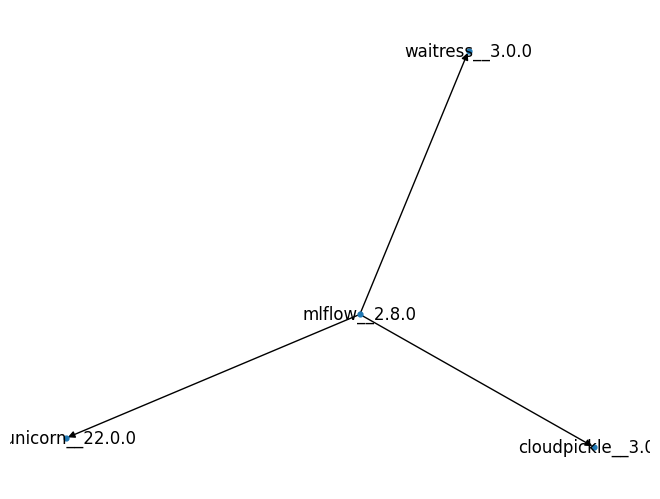

,waitress,mlflow*,cloudpickle,gunicorn
0,3.0.0,2.8.0,3.0.0,22.0.0
1,3.0.0,2.8.1,3.0.0,22.0.0
2,3.0.0,2.9.0,NaN,22.0.0
3,3.0.0,2.9.1,NaN,22.0.0
4,3.0.0,2.9.2,NaN,22.0.0


i:1, j:0
jinja2__3.1.4 -> Babel__2.9.1
pandas__2.2.1 -> bottleneck__1.3.8
pandas__2.2.1 -> jinja2__3.1.4
pandas__2.2.1 -> odfpy__1.4.1
pandas__2.2.1 -> openpyxl__3.1.2
pandas__2.2.1 -> psycopg2__2.9.9
pandas__2.2.1 -> pymysql__1.1.1
pandas__2.2.1 -> qtpy__2.4.1
pandas__2.2.1 -> tables__3.9.2
pandas__2.2.1 -> tabulate__0.9.0
pandas__2.2.1 -> xlrd__2.0.1
pymysql__1.1.1 -> PyNaCl__1.5.0


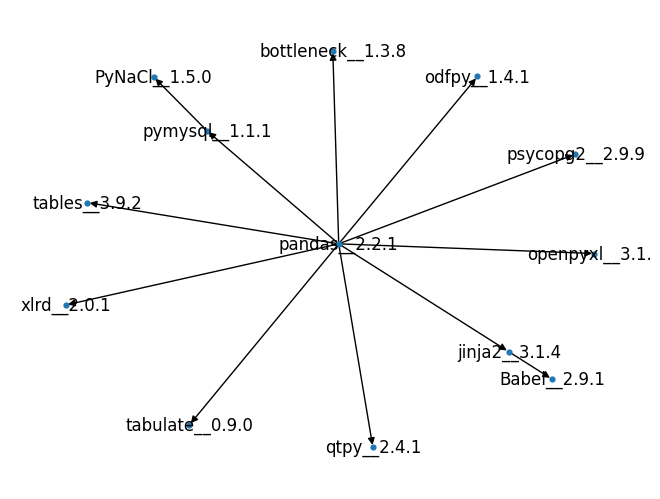

,qtpy,pymysql*,Babel,PyNaCl,tables,odfpy,openpyxl,psycopg2,tabulate,pandas*,bottleneck,jinja2*,xlrd
0,2.4.1,1.1.1,2.9.1,1.5.0,3.9.2,1.4.1,3.1.2,2.9.9,0.9.0,2.2.1,1.3.8,3.1.4,2.0.1
1,2.4.1,1.1.1,2.9.1,1.5.0,3.9.2,1.4.1,3.1.2,2.9.9,0.9.0,2.2.2,1.3.8,3.1.4,2.0.1


i:2, j:0
tensorflow__2.8.4 -> astunparse__1.6.3
tensorflow__2.8.4 -> libclang__9.0.1


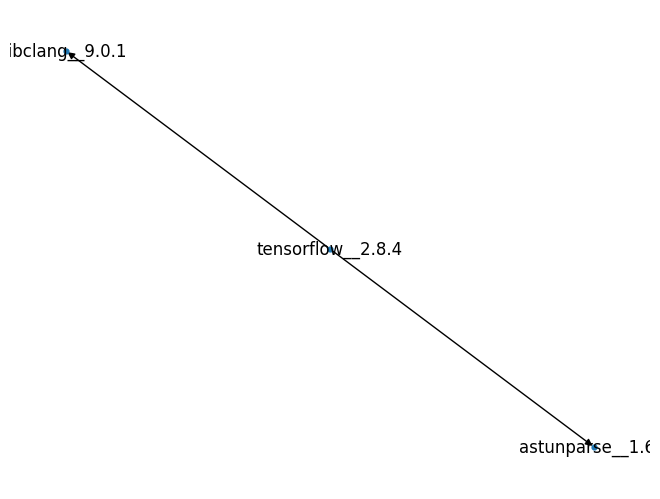

,libclang,astunparse,tensorflow*
0,9.0.1,1.6.3,2.8.4
1,NaN,1.6.3,2.9.0
2,NaN,1.6.3,2.9.1
3,NaN,1.6.3,2.9.2
4,NaN,1.6.3,2.9.3


i:3, j:0
aiohttp__3.9.1 -> aiosignal__1.3.1


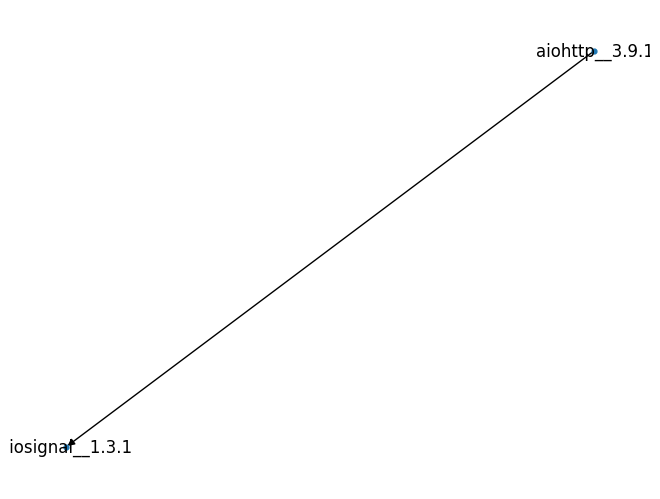

,aiohttp*,aiosignal
0,3.9.1,1.3.1
1,3.9.2,1.3.1
2,3.9.3,1.3.1
3,3.9.4,1.3.1
4,3.9.5,1.3.1


In [26]:
import networkx as nx
import matplotlib.pyplot as plt
from IPython.display import display, HTML
import pandas as pd

# Indicate which packages are sufficient to pull the rests. This can help you freeze less packages, allowing your dependency resolution to stay flexible
roots = {*it.chain(*compound_groups)}
for i in range(len(compat_sets)):
    for j in range(min(len(compat_sets[i]), 1)):
        print(f"i:{i}, j:{j}")
        selection = {m.get_key(): m for m in compat_sets[i][j]}
        chart2 = ChartPackages(selection)
        SIZE2 = len(selection)
        T2 = nx.DiGraph()
        for k in range(SIZE2):
            for l in range(SIZE2):
                if chart2.adj[k][l] == 1:
                    # try:
                    print(f'{chart2.vertices[k].replace("::", "__")} -> {chart2.vertices[l].replace("::", "__")}')
                    T2.add_edge(chart2.vertices[k].replace("::", "__"), chart2.vertices[l].replace("::", "__"))

        # pos = nx.nx_pydot.pydot_layout(T, prog='dot') #nx.spring_layout(T,k=0.15,iterations=20)  
        # plt.figure(2, figsize=(100,75))
        nx.draw(T2, node_size=12, font_size=12, with_labels=True)
        plt.show()
    pdf = pd.DataFrame.from_records(
        [*map(lambda x: {y.name if not chart.vertex_lookup[y.get_key()] in roots else f'{y.name}*': y.version for y in x}, compat_sets[i])])
    display(HTML(pdf.to_html()))

### Troubleshooting

We cache the package, please change the above call and pass the argument 'True' to invalidate cache and refresh pull from [pypi](https://pypi.org). **NOTE:** This could take hours! 

```python
PkgGraph(dependencies, session, trailing).resolve(True)
``` 

The default configuration is to pull the last `5` versions of packages that can be linked from the `dependencies` list. If you need more comprehensive history, change this number accordingly.